<a href="https://colab.research.google.com/github/mohripan/Machine-Learning/blob/main/AdvancedGans.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision
import PIL
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader, Dataset
from tqdm.auto import tqdm
from PIL import Image
import pdb
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1, 2, 0)

  if(wandbactive==1 and wandbact==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0, 1))})
  plt.imshow(grid.clip(0, 1))
  plt.show()

In [3]:
num_epochs = 30
batch_size = 128
lr = 3e-4
z_dim = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

cur_step = 0
crit_cycles = 5
gen_losses = np.zeros(num_epochs)
crit_losses = np.zeros(num_epochs)
show_step = 35
save_step = 35

wandbact = 1

In [4]:
!pip install wandb -qqq
import wandb
wandb.login(key='cc9f569b88bc27f847cb8f81064673032285383d')

     |████████████████████████████████| 1.7 MB 5.2 MB/s 
     |████████████████████████████████| 180 kB 49.1 MB/s 
     |████████████████████████████████| 139 kB 42.4 MB/s 
     |████████████████████████████████| 97 kB 6.3 MB/s 
     |████████████████████████████████| 63 kB 1.5 MB/s 


wandb: W&B API key is configured (use `wandb login --relogin` to force relogin)
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publically.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [5]:
%%capture
experiment_name = wandb.util.generate_id()

my_run = wandb.init(
    project='wgan',
    group=experiment_name,
    config={
        'optimizer': 'sgd',
        'model': 'wgan gp',
        'epoch': '30',
        'batch_size': 128
    }
)

config = wandb.config

print(experiment_name)

In [6]:
print(experiment_name)

2meukp5q


In [7]:
class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim = z_dim

    self.gen = nn.Sequential(
        self.conv_t_block(z_dim, d_dim*32, 4, 1, 0),
        self.conv_t_block(d_dim*32, d_dim*16, 4, 2, 1),
        self.conv_t_block(d_dim*16, d_dim*8, 4, 2, 1),
        self.conv_t_block(d_dim*8, d_dim*4, 4, 2, 1),
        self.conv_t_block(d_dim*4, d_dim*2, 4, 2, 1),
        nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1),
        nn.Tanh()
    )

  def forward(self, x):
    x = x.view(len(x), self.z_dim, 1, 1)
    return self.gen(x)

  def conv_t_block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding),
                         nn.BatchNorm2d(out_channels),
                         nn.ReLU(True))

In [8]:
class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()
    self.crit = nn.Sequential(self.crit_block(3, d_dim, 4, 2, 1),
                              self.crit_block(d_dim, d_dim*2, 4, 2, 1),
                              self.crit_block(d_dim*2, d_dim*4, 4, 2, 1),
                              self.crit_block(d_dim*4, d_dim*8, 4, 2, 1),
                              self.crit_block(d_dim*8, d_dim*16, 4, 2, 1),
                              nn.Conv2d(d_dim*16, 1, 4, 1, 0),)
    
  def forward(self, x):
    crit_pred = self.crit(x)
    return crit_pred.view(len(crit_pred), -1)

  def crit_block(self, in_channels, out_channels, kernel, stride, padding):
    return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel_size=kernel, stride=stride, padding=padding),
                         nn.InstanceNorm2d(out_channels),
                         nn.LeakyReLU(0.2))

In [9]:
def gen_noise(num, z_dim):
  return torch.randn(num, z_dim).to(device)

In [10]:
def init_weights(m):
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

In [11]:
import gdown, zipfile

In [12]:
url = 'https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH'
path = 'data/celeba'
download_path = f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)

Downloading...
From: https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH
To: /content/data/celeba/img_align_celeba.zip
100%|██████████| 1.44G/1.44G [00:08<00:00, 173MB/s]


In [13]:
class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes = [size, size]
    items, labels = [], []

    for data in os.listdir(path)[:lim]:
      item = os.path.join(path, data)
      items.append(item)
      labels.append(data)

    self.items = items
    self.labels = labels

  def __len__(self):
    return len(self.items)

  def __getitem__(self, idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB')
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data))
    data = np.transpose(data, (2, 0, 1)).astype(np.float32, copy=False)
    data = torch.from_numpy(data).div(255)
    return data, self.labels[idx]

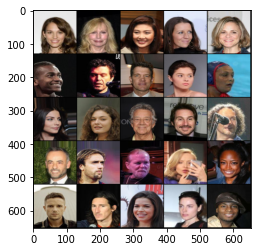

In [14]:
data_path = './data/celeba/img_align_celeba'
dataset = Dataset(data_path, size=128, lim=10000)

data_loader = DataLoader(dataset, batch_size=128, shuffle=True)

gen = Generator(z_dim).to(device)
crit = Critic().to(device)

gen_opt = optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.9))
crit_opt = optim.Adam(crit.parameters(), lr=lr, betas=(0.5, 0.9))

if(wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x, y = next(iter(data_loader))
show(x)

In [20]:
def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real*alpha+fake*(1-alpha)
  mix_scores = crit(mix_images)

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs= mix_scores,
      grad_outputs = torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0]

  gradient = gradient.view(len(gradient), -1)
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma*((gradient_norm-1)**2).mean()

  return gp

In [21]:
root_path = './data/'

def save_checkpoint(name, epoch):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f'{root_path}G-{name}.pkl')

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f'{root_path}C-{name}.pkl')

  print('Saved checkpoint')

In [22]:
def load_checkpoint(name, epoch):
  checkpoint = torch.load(f'{root_path}G-{name}.pkl')
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f'{root_path}G-{name}.pkl')
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print('Loaded checkpoint')

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  35 35
Saved checkpoint


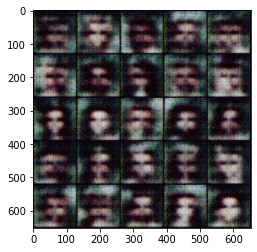

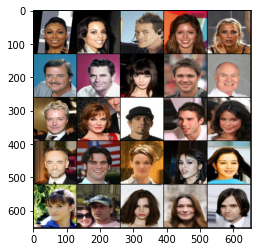

Epoch: 1, Step: 35, Generator Loss: 840.3653, Critic_loss: -949.5325


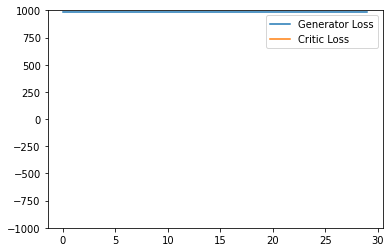

Saving checkpoint:  70 35
Saved checkpoint


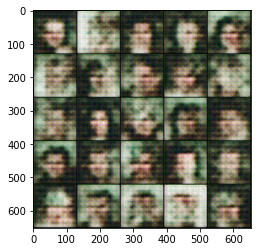

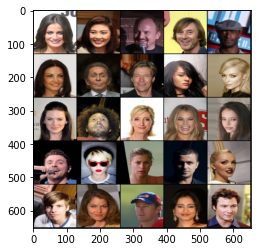

Epoch: 1, Step: 70, Generator Loss: 1547.4607, Critic_loss: -1830.7991


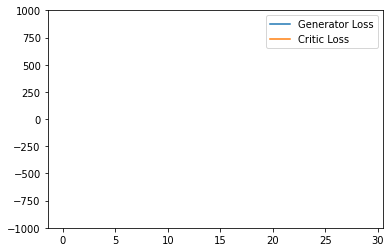

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  105 35
Saved checkpoint


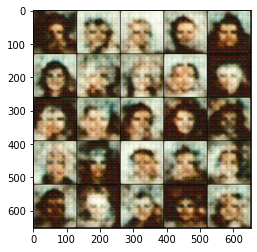

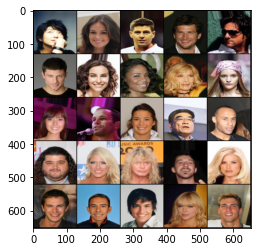

Epoch: 2, Step: 105, Generator Loss: 1950.3675, Critic_loss: -2358.2635


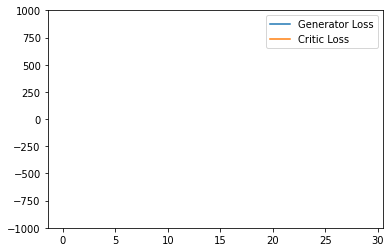

Saving checkpoint:  140 35
Saved checkpoint


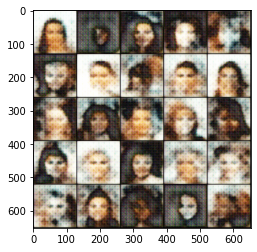

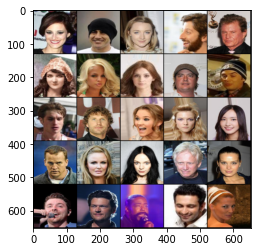

Epoch: 2, Step: 140, Generator Loss: 2235.2890, Critic_loss: -2765.7674


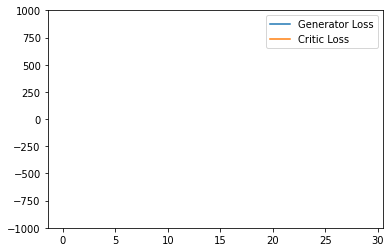

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  175 35
Saved checkpoint


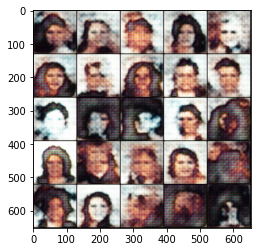

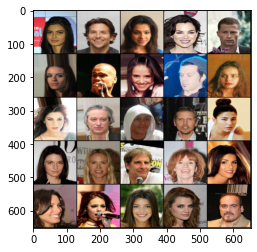

Epoch: 3, Step: 175, Generator Loss: 2542.9101, Critic_loss: -3133.6559


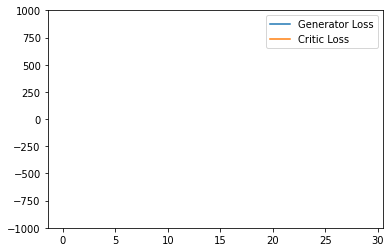

Saving checkpoint:  210 35
Saved checkpoint


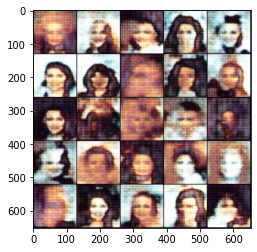

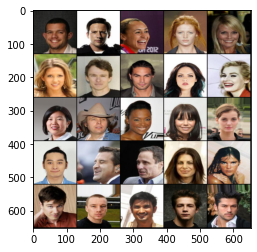

Epoch: 3, Step: 210, Generator Loss: 2754.2444, Critic_loss: -3452.7800


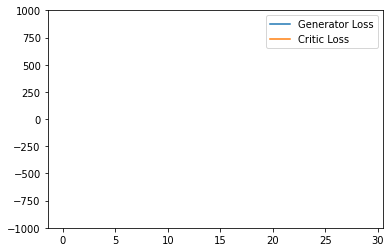

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  245 35
Saved checkpoint


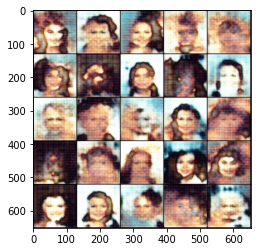

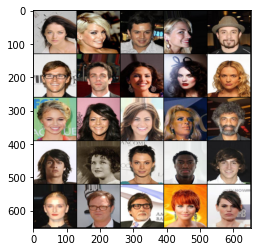

Epoch: 4, Step: 245, Generator Loss: 2960.5469, Critic_loss: -3746.1695


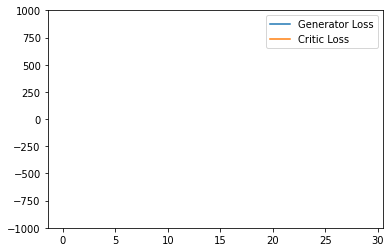

Saving checkpoint:  280 35
Saved checkpoint


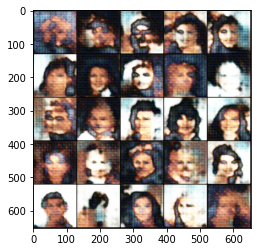

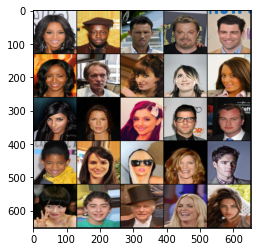

Epoch: 4, Step: 280, Generator Loss: 3196.8298, Critic_loss: -4018.6830


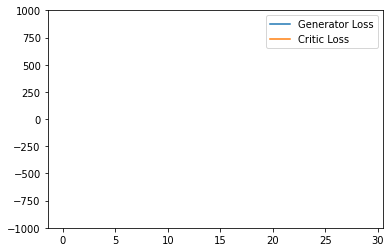

Saving checkpoint:  315 35
Saved checkpoint


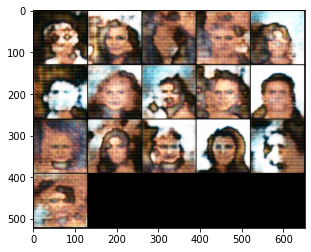

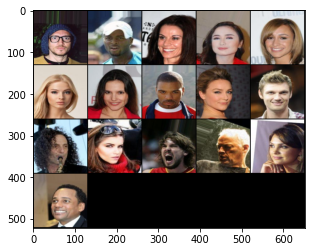

Epoch: 4, Step: 315, Generator Loss: 3481.2063, Critic_loss: -4280.9066


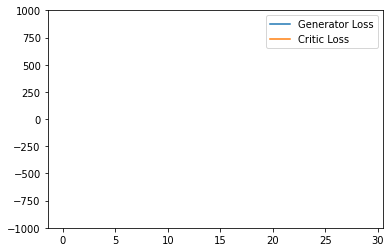

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  350 35
Saved checkpoint


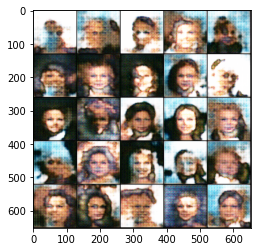

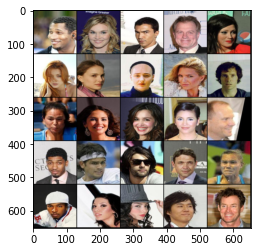

Epoch: 5, Step: 350, Generator Loss: 3775.5768, Critic_loss: -4535.1493


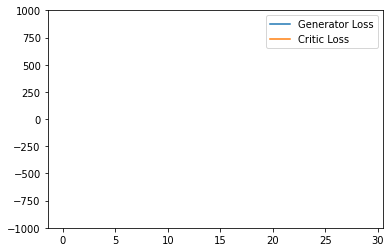

Saving checkpoint:  385 35
Saved checkpoint


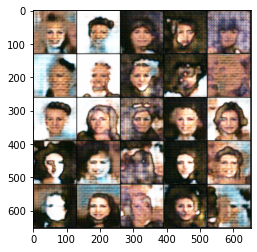

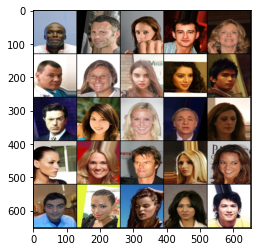

Epoch: 5, Step: 385, Generator Loss: 4066.6666, Critic_loss: -4791.7595


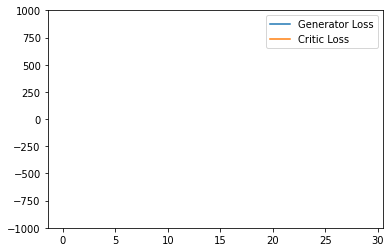

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  420 35
Saved checkpoint


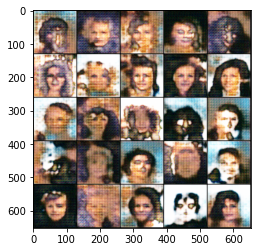

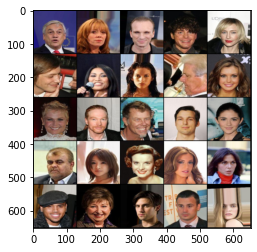

Epoch: 6, Step: 420, Generator Loss: 4385.5901, Critic_loss: -5046.7562


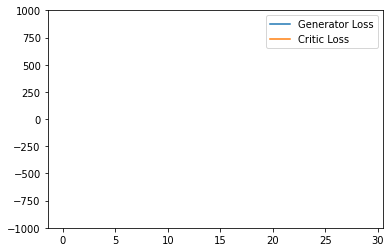

Saving checkpoint:  455 35
Saved checkpoint


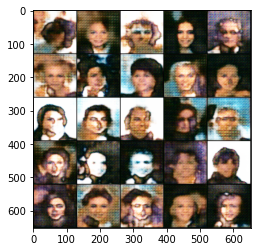

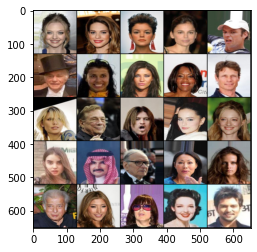

Epoch: 6, Step: 455, Generator Loss: 4694.3140, Critic_loss: -5297.9186


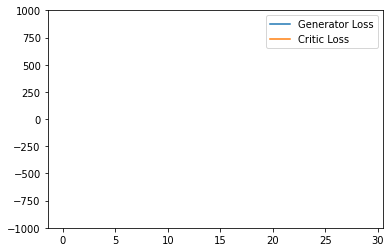

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  490 35
Saved checkpoint


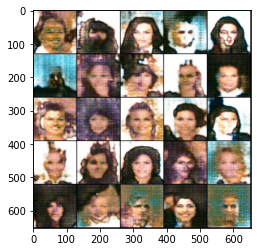

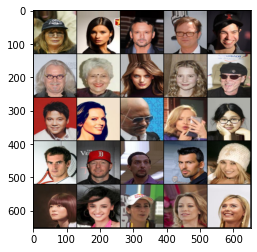

Epoch: 7, Step: 490, Generator Loss: 5010.4476, Critic_loss: -5538.2288


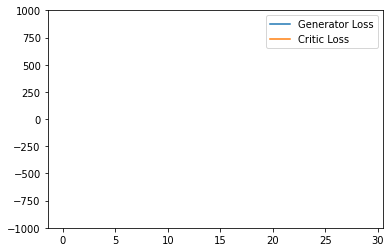

Saving checkpoint:  525 35
Saved checkpoint


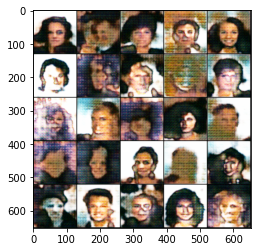

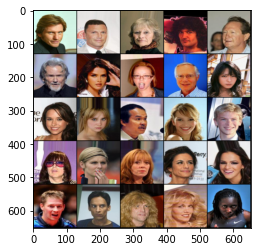

Epoch: 7, Step: 525, Generator Loss: 5306.9525, Critic_loss: -5782.1835


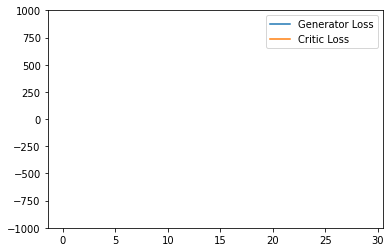

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 35
Saved checkpoint


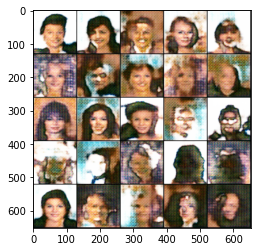

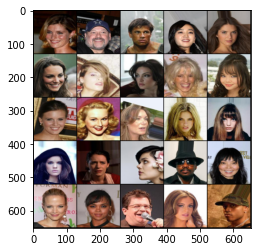

Epoch: 8, Step: 560, Generator Loss: 5601.2374, Critic_loss: -6033.7155


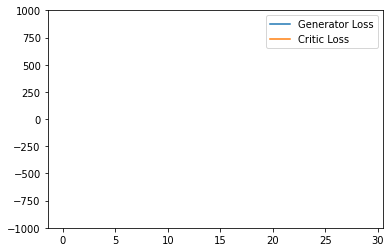

Saving checkpoint:  595 35
Saved checkpoint


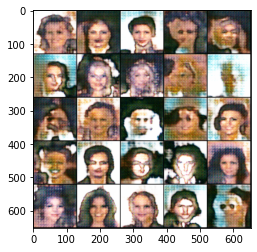

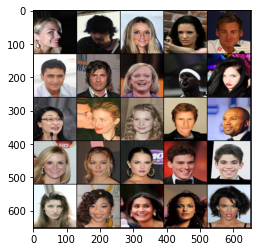

Epoch: 8, Step: 595, Generator Loss: 5904.0617, Critic_loss: -6266.5733


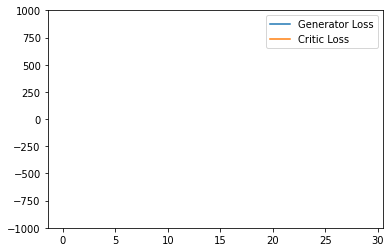

Saving checkpoint:  630 35
Saved checkpoint


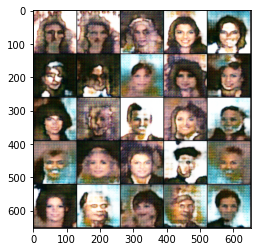

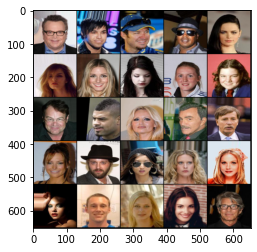

Epoch: 8, Step: 630, Generator Loss: 6194.0288, Critic_loss: -6493.1763


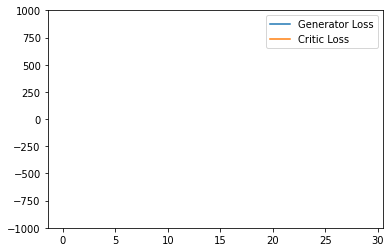

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  665 35
Saved checkpoint


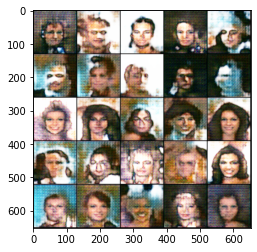

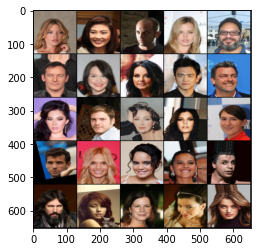

Epoch: 9, Step: 665, Generator Loss: 6466.4065, Critic_loss: -6728.1092


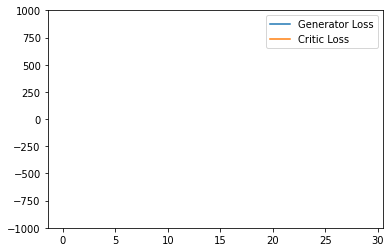

Saving checkpoint:  700 35
Saved checkpoint


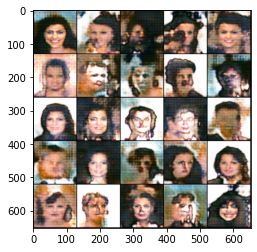

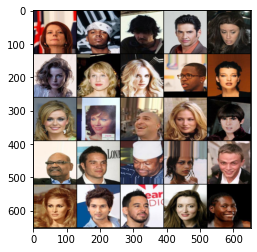

Epoch: 9, Step: 700, Generator Loss: 6748.0881, Critic_loss: -6949.9835


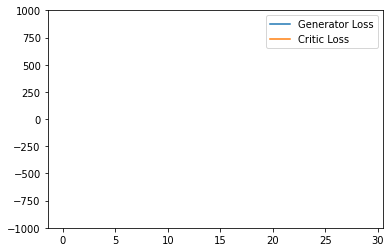

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  735 35
Saved checkpoint


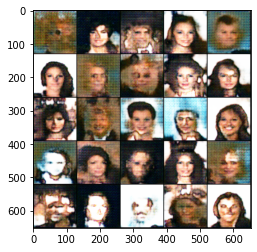

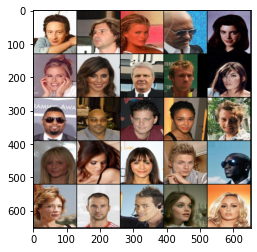

Epoch: 10, Step: 735, Generator Loss: 7035.6741, Critic_loss: -7174.4995


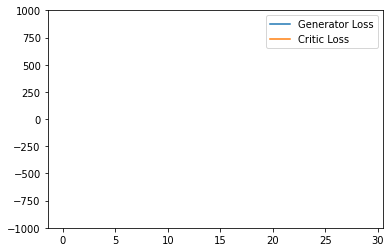

Saving checkpoint:  770 35
Saved checkpoint


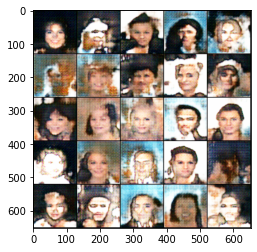

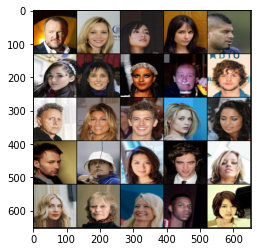

Epoch: 10, Step: 770, Generator Loss: 7312.4381, Critic_loss: -7402.6731


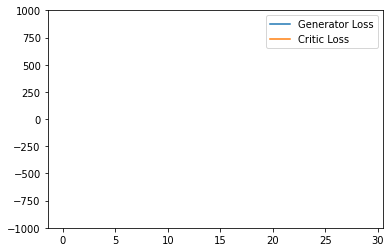

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  805 35
Saved checkpoint


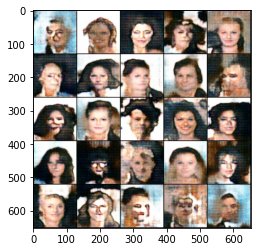

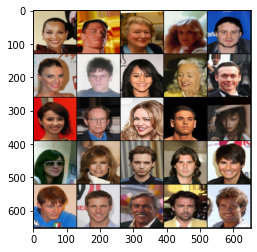

Epoch: 11, Step: 805, Generator Loss: 7559.7182, Critic_loss: -7623.1995


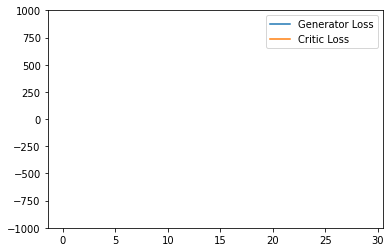

Saving checkpoint:  840 35
Saved checkpoint


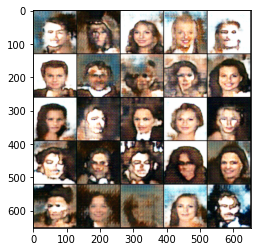

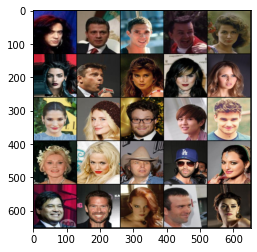

Epoch: 11, Step: 840, Generator Loss: 7848.2934, Critic_loss: -7847.4941


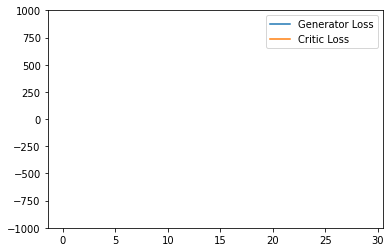

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  875 35
Saved checkpoint


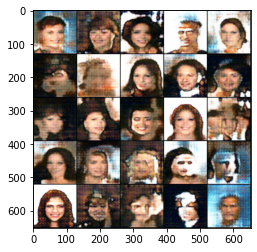

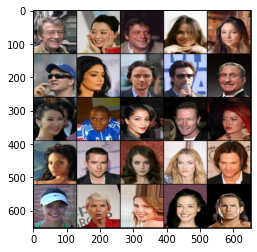

Epoch: 12, Step: 875, Generator Loss: 8104.9430, Critic_loss: -8060.4021


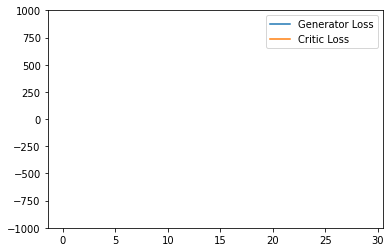

Saving checkpoint:  910 35
Saved checkpoint


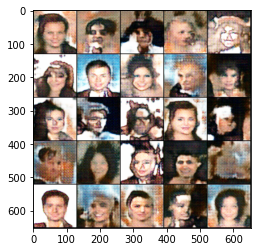

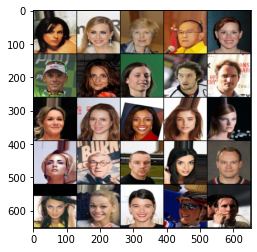

Epoch: 12, Step: 910, Generator Loss: 8347.6219, Critic_loss: -8276.5698


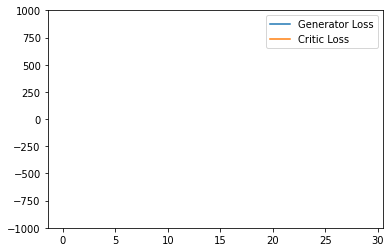

Saving checkpoint:  945 35
Saved checkpoint


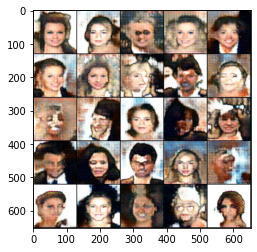

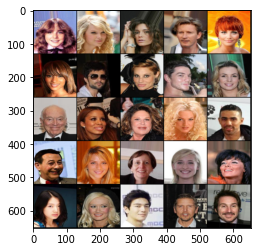

Epoch: 12, Step: 945, Generator Loss: 8564.3061, Critic_loss: -8487.8531


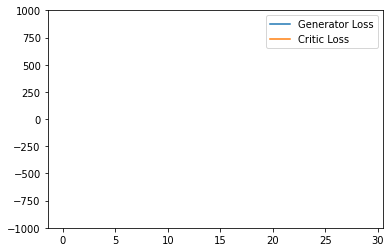

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  980 35
Saved checkpoint


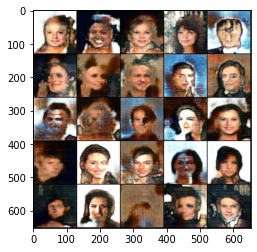

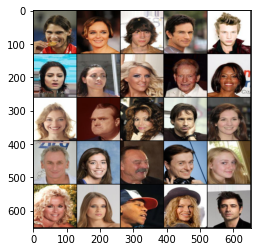

Epoch: 13, Step: 980, Generator Loss: 8746.9655, Critic_loss: -8704.2177


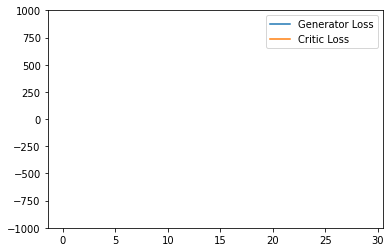

Saving checkpoint:  1015 35
Saved checkpoint


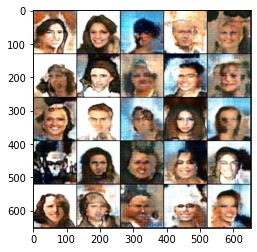

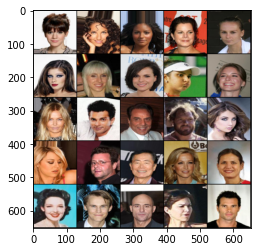

Epoch: 13, Step: 1015, Generator Loss: 8933.0892, Critic_loss: -8909.8802


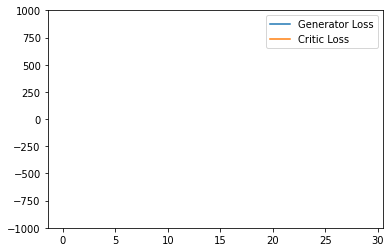

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1050 35
Saved checkpoint


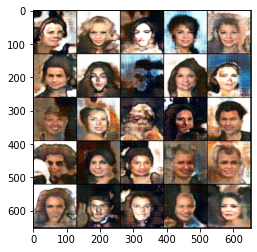

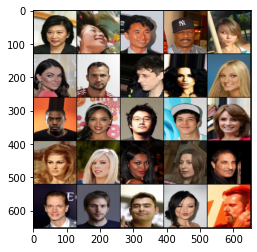

Epoch: 14, Step: 1050, Generator Loss: 9133.5510, Critic_loss: -9128.3445


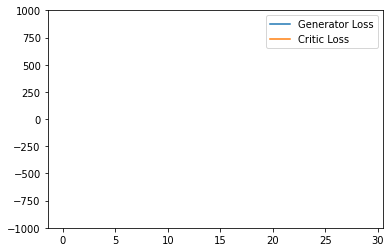

Saving checkpoint:  1085 35
Saved checkpoint


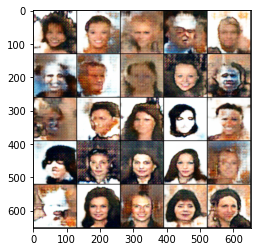

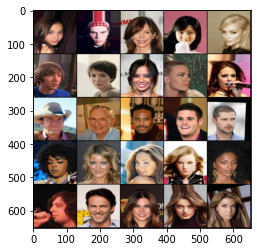

Epoch: 14, Step: 1085, Generator Loss: 9336.2058, Critic_loss: -9329.6837


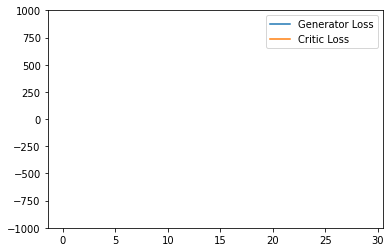

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1120 35
Saved checkpoint


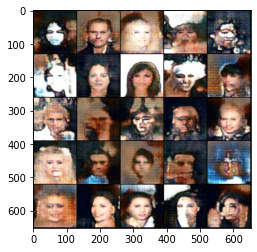

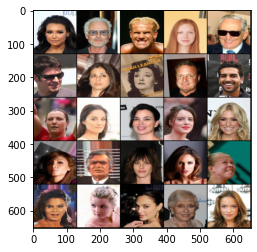

Epoch: 15, Step: 1120, Generator Loss: 9529.9351, Critic_loss: -9536.7295


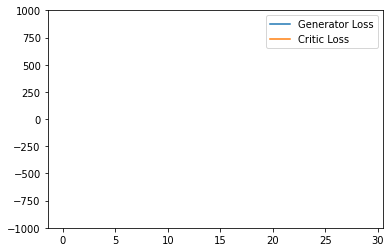

Saving checkpoint:  1155 35
Saved checkpoint


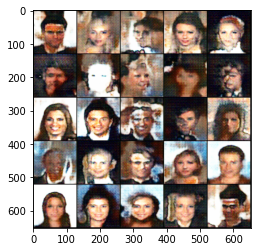

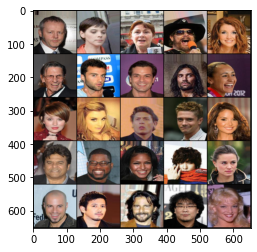

Epoch: 15, Step: 1155, Generator Loss: 9658.0521, Critic_loss: -9740.1047


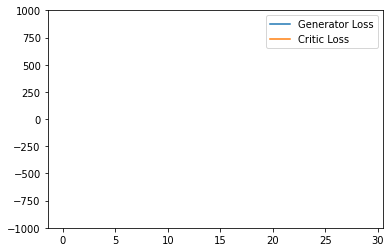

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1190 35
Saved checkpoint


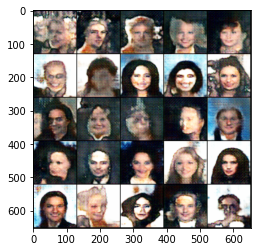

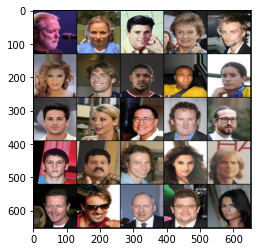

Epoch: 16, Step: 1190, Generator Loss: 9789.0424, Critic_loss: -9945.4959


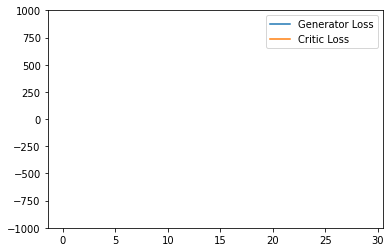

Saving checkpoint:  1225 35
Saved checkpoint


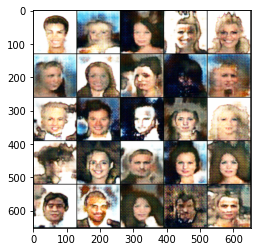

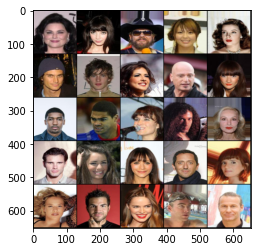

Epoch: 16, Step: 1225, Generator Loss: 9871.8007, Critic_loss: -10154.0892


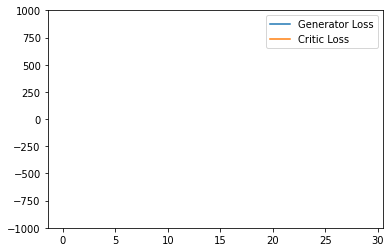

Saving checkpoint:  1260 35
Saved checkpoint


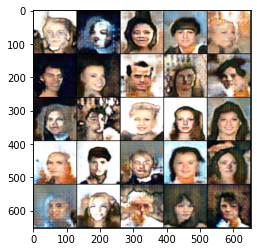

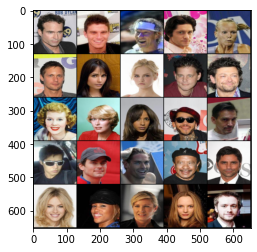

Epoch: 16, Step: 1260, Generator Loss: 9947.4987, Critic_loss: -10350.5954


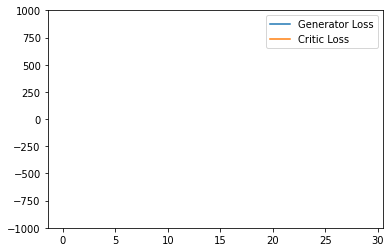

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1295 35
Saved checkpoint


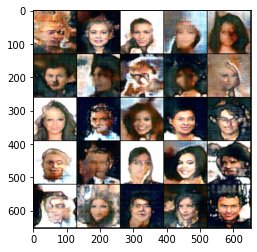

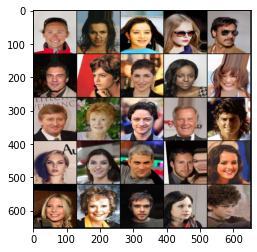

Epoch: 17, Step: 1295, Generator Loss: 10019.2685, Critic_loss: -10552.4214


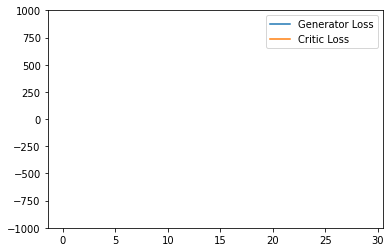

Saving checkpoint:  1330 35
Saved checkpoint


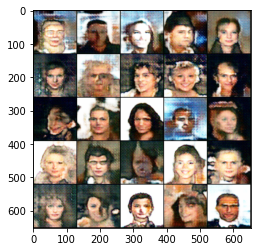

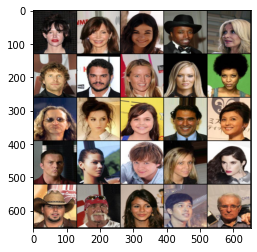

Epoch: 17, Step: 1330, Generator Loss: 10084.1804, Critic_loss: -10745.0245


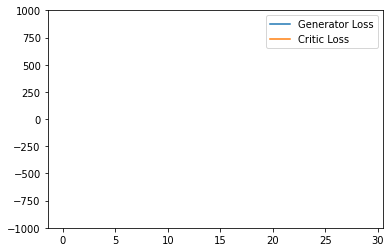

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1365 35
Saved checkpoint


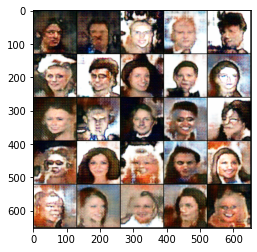

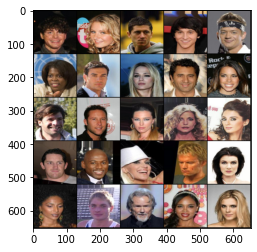

Epoch: 18, Step: 1365, Generator Loss: 10122.7399, Critic_loss: -10940.6426


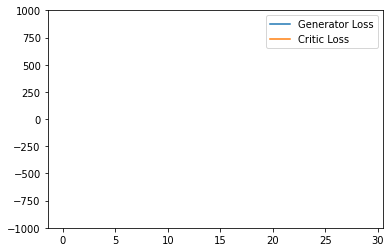

Saving checkpoint:  1400 35
Saved checkpoint


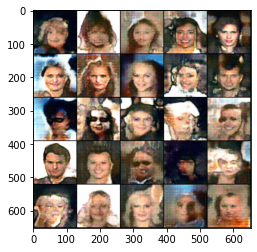

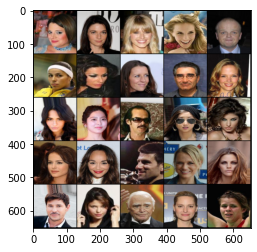

Epoch: 18, Step: 1400, Generator Loss: 10196.9528, Critic_loss: -11133.9195


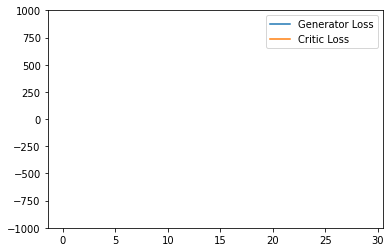

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1435 35
Saved checkpoint


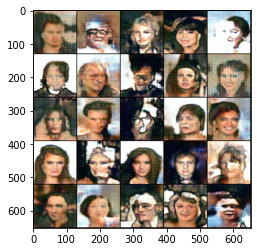

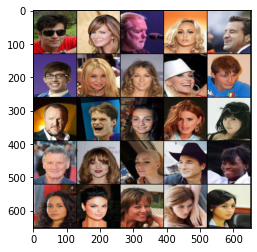

Epoch: 19, Step: 1435, Generator Loss: 10232.1213, Critic_loss: -11327.4046


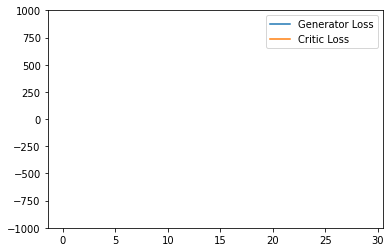

Saving checkpoint:  1470 35
Saved checkpoint


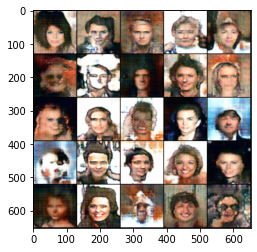

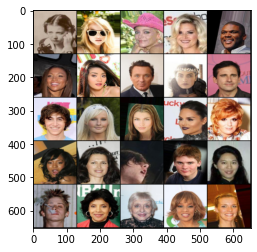

Epoch: 19, Step: 1470, Generator Loss: 10296.4277, Critic_loss: -11523.6381


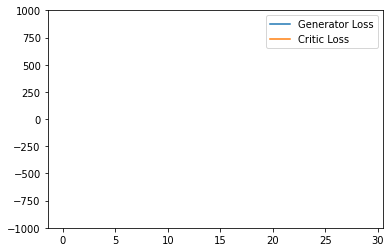

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1505 35
Saved checkpoint


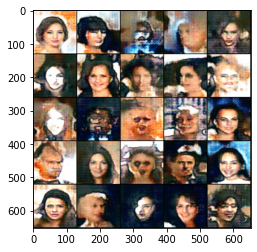

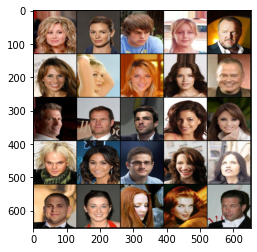

Epoch: 20, Step: 1505, Generator Loss: 10310.5850, Critic_loss: -11712.9204


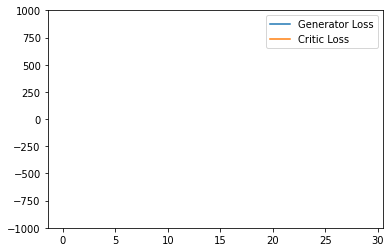

Saving checkpoint:  1540 35
Saved checkpoint


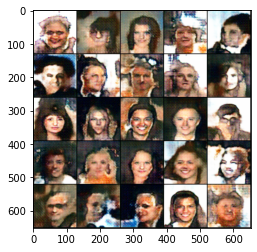

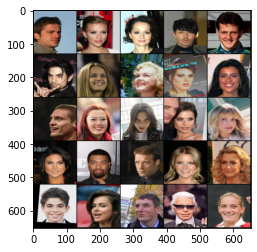

Epoch: 20, Step: 1540, Generator Loss: 10345.3620, Critic_loss: -11904.0801


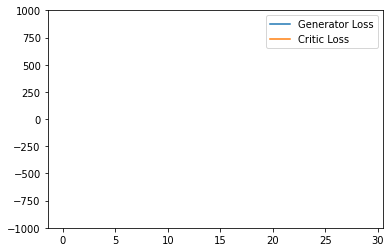

Saving checkpoint:  1575 35
Saved checkpoint


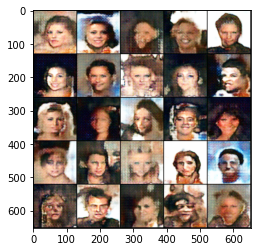

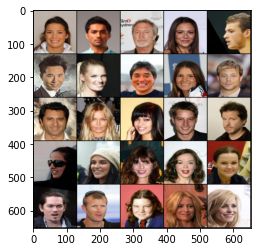

Epoch: 20, Step: 1575, Generator Loss: 10355.3628, Critic_loss: -12089.6912


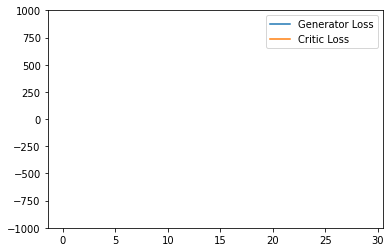

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1610 35
Saved checkpoint


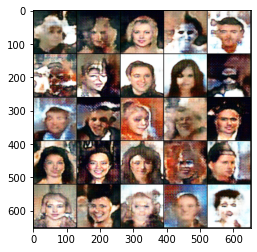

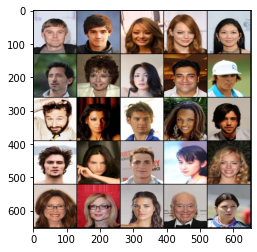

Epoch: 21, Step: 1610, Generator Loss: 10373.9536, Critic_loss: -12279.8309


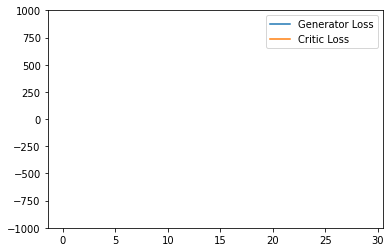

Saving checkpoint:  1645 35
Saved checkpoint


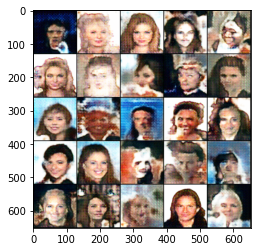

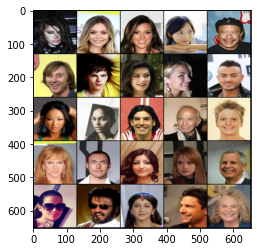

Epoch: 21, Step: 1645, Generator Loss: 10381.4534, Critic_loss: -12462.6324


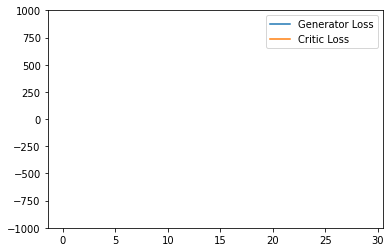

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1680 35
Saved checkpoint


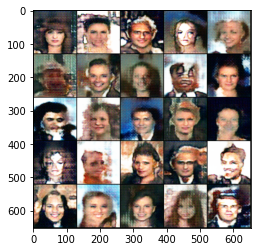

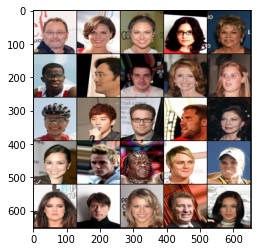

Epoch: 22, Step: 1680, Generator Loss: 10422.0990, Critic_loss: -12646.6639


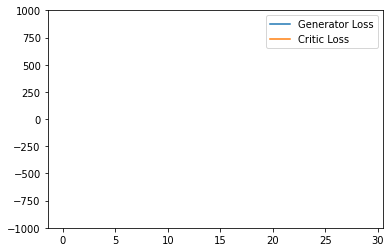

Saving checkpoint:  1715 35
Saved checkpoint


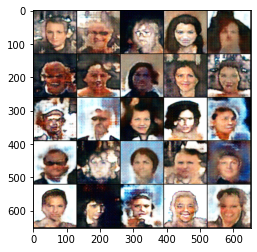

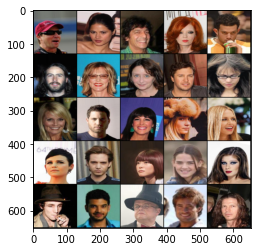

Epoch: 22, Step: 1715, Generator Loss: 10432.2704, Critic_loss: -12825.7827


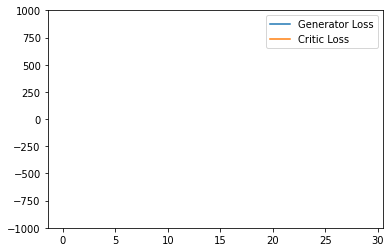

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1750 35
Saved checkpoint


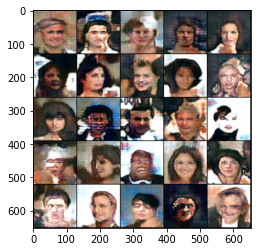

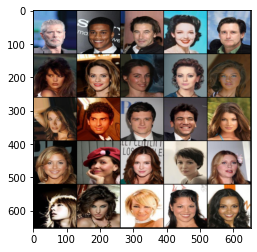

Epoch: 23, Step: 1750, Generator Loss: 10441.4938, Critic_loss: -13007.1003


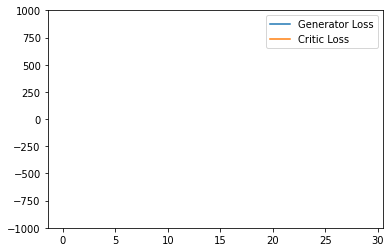

Saving checkpoint:  1785 35
Saved checkpoint


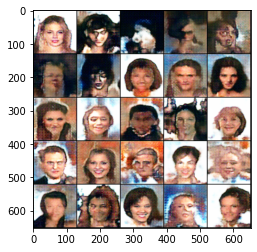

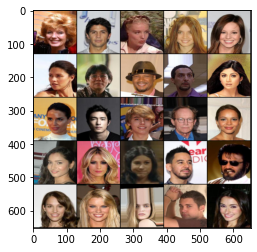

Epoch: 23, Step: 1785, Generator Loss: 10427.0369, Critic_loss: -13185.3853


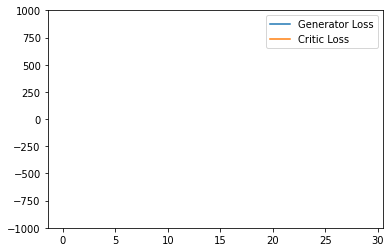

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1820 35
Saved checkpoint


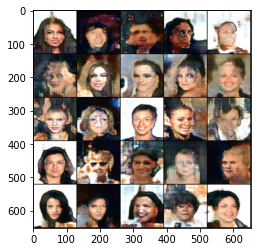

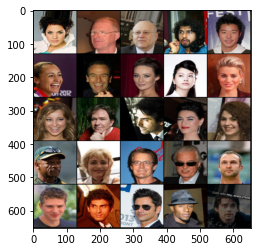

Epoch: 24, Step: 1820, Generator Loss: 10395.2132, Critic_loss: -13355.8696


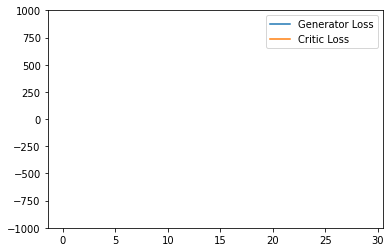

Saving checkpoint:  1855 35
Saved checkpoint


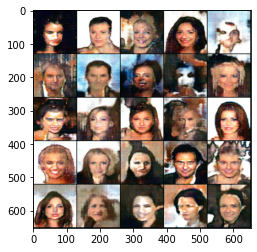

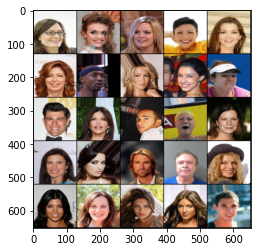

Epoch: 24, Step: 1855, Generator Loss: 10377.6557, Critic_loss: -13531.7126


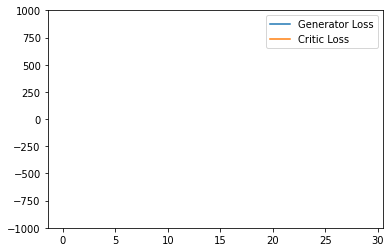

Saving checkpoint:  1890 35
Saved checkpoint


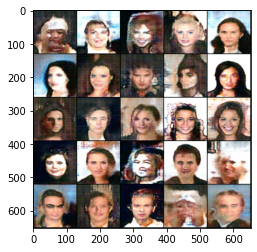

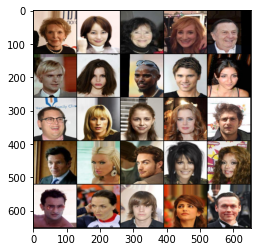

Epoch: 24, Step: 1890, Generator Loss: 10343.5352, Critic_loss: -13705.9184


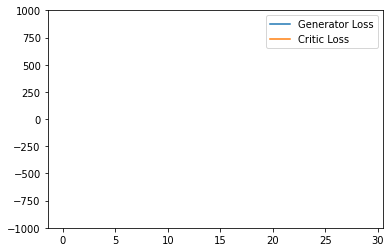

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1925 35
Saved checkpoint


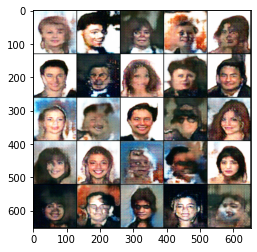

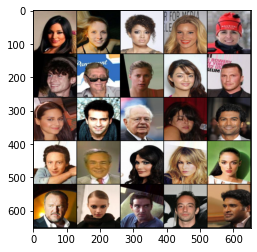

Epoch: 25, Step: 1925, Generator Loss: 10325.1265, Critic_loss: -13885.9433


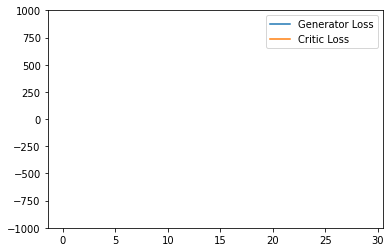

Saving checkpoint:  1960 35
Saved checkpoint


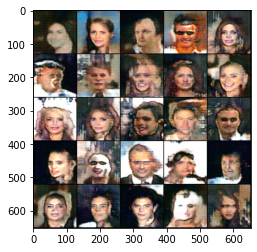

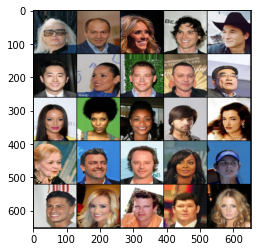

Epoch: 25, Step: 1960, Generator Loss: 10298.3771, Critic_loss: -14053.3452


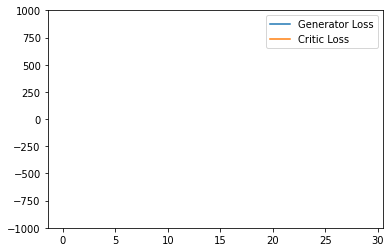

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1995 35
Saved checkpoint


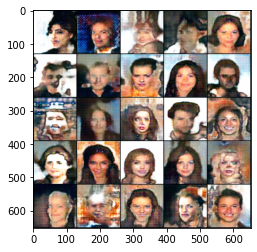

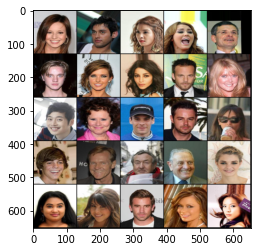

Epoch: 26, Step: 1995, Generator Loss: 10270.4485, Critic_loss: -14223.9265


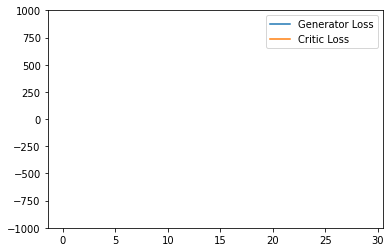

Saving checkpoint:  2030 35
Saved checkpoint


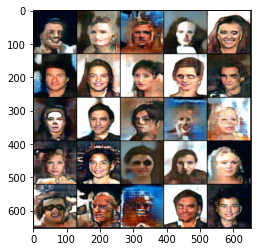

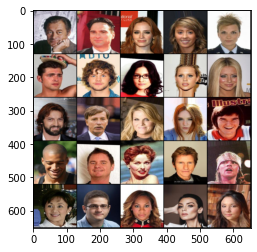

Epoch: 26, Step: 2030, Generator Loss: 10254.4945, Critic_loss: -14394.3109


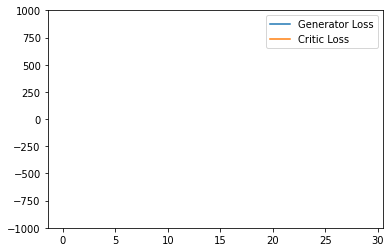

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2065 35
Saved checkpoint


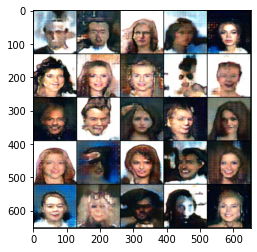

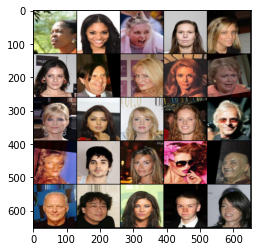

Epoch: 27, Step: 2065, Generator Loss: 10228.1229, Critic_loss: -14560.3029


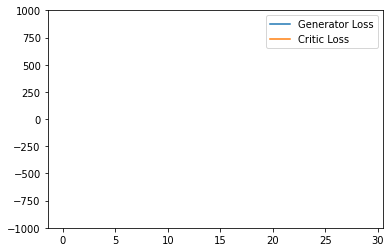

Saving checkpoint:  2100 35
Saved checkpoint


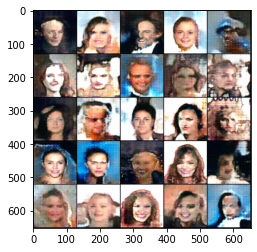

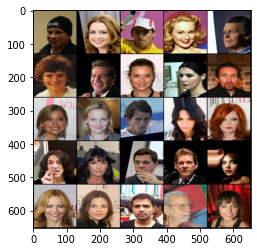

Epoch: 27, Step: 2100, Generator Loss: 10217.9294, Critic_loss: -14731.1331


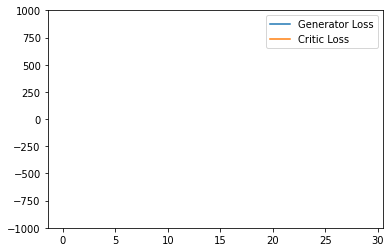

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2135 35
Saved checkpoint


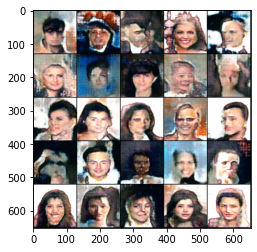

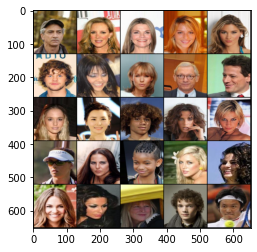

Epoch: 28, Step: 2135, Generator Loss: 10162.1158, Critic_loss: -14897.0108


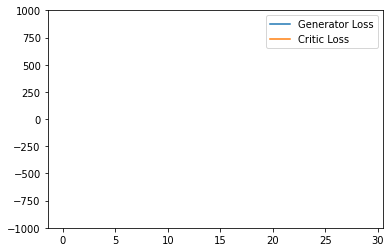

Saving checkpoint:  2170 35
Saved checkpoint


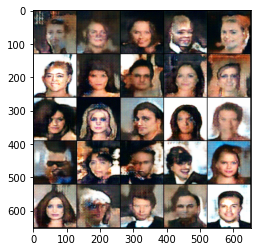

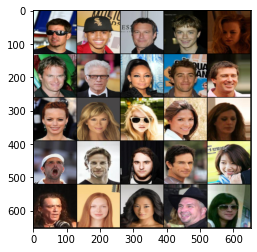

Epoch: 28, Step: 2170, Generator Loss: 10147.2467, Critic_loss: -15069.1272


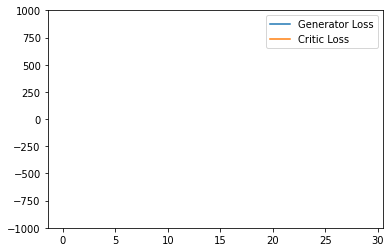

Saving checkpoint:  2205 35
Saved checkpoint


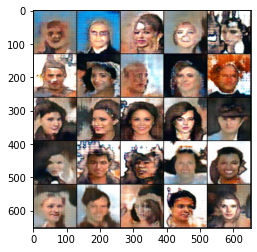

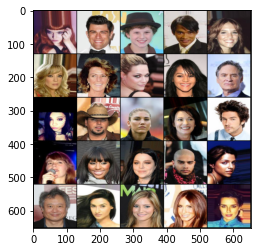

Epoch: 28, Step: 2205, Generator Loss: 10103.5740, Critic_loss: -15229.2906


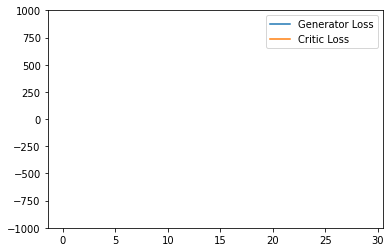

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2240 35
Saved checkpoint


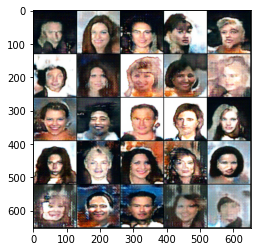

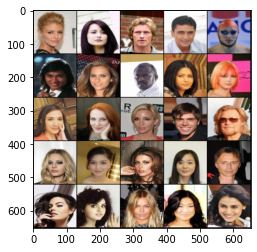

Epoch: 29, Step: 2240, Generator Loss: 10060.4906, Critic_loss: -15396.6967


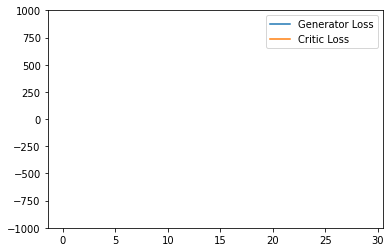

Saving checkpoint:  2275 35
Saved checkpoint


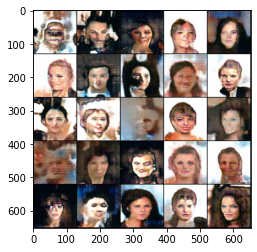

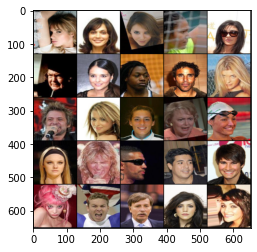

Epoch: 29, Step: 2275, Generator Loss: 10034.7139, Critic_loss: -15557.4444


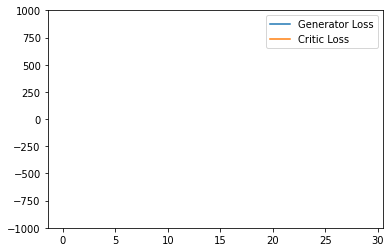

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2310 35
Saved checkpoint


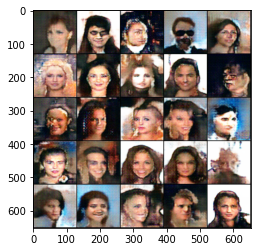

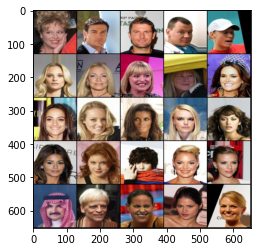

Epoch: 30, Step: 2310, Generator Loss: 9976.1640, Critic_loss: -15724.8364


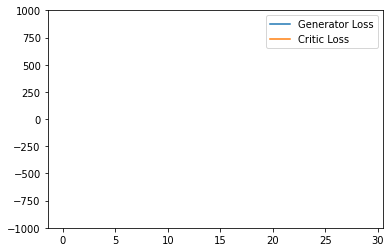

Saving checkpoint:  2345 35
Saved checkpoint


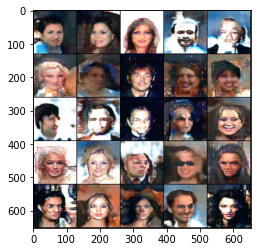

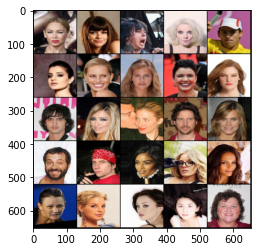

Epoch: 30, Step: 2345, Generator Loss: 9941.9831, Critic_loss: -15891.9010


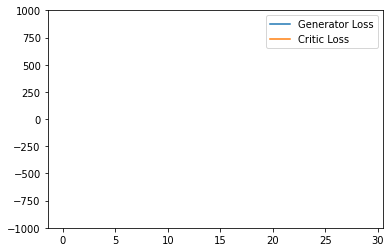

In [23]:
for i in range(num_epochs):
  for real, _ in tqdm(data_loader):
    cur_bs = len(real)
    real = real.to(device)

    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise = gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss += crit_loss.item()/crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+= [mean_crit_loss]

    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+= [gen_loss.item()]

    if (wandbact==1):
      wandb.log({'Epoch': i, 'Step': cur_step, 'Critic loss': mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step >0:
      print('Saving checkpoint: ', cur_step, save_step)
      save_checkpoint('celeb_model', i)

    if (cur_step%show_step == 0 and cur_step>0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean = sum(gen_losses[-show_step:])/show_step
      crit_mean = sum(crit_losses[-show_step:])/show_step
      print(f'Epoch: {i+1}, Step: {cur_step}, Generator Loss: {gen_mean:.4f}, Critic_loss: {crit_mean:.4f}')

      plt.plot(range(len(gen_losses)),
               torch.Tensor(gen_losses),
               label='Generator Loss')
      
      plt.plot(range(len(crit_losses)),
               torch.Tensor(crit_losses),
               label='Critic Loss')
      
      plt.ylim(-1000, 1000)
      plt.legend()
      plt.show()

    cur_step += 1

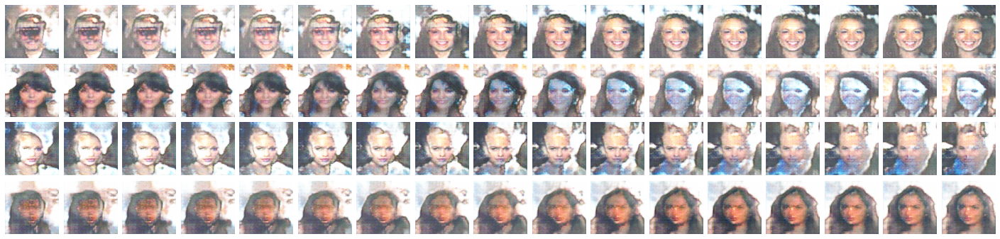

In [24]:
from mpl_toolkits.axes_grid1 import ImageGrid

gen_set = []
z_shape = [1,200, 1, 1]
rows = 4
steps = 17

for i in range(rows):
  z1, z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1, steps):
    z = alpha*z1+(1-alpha)*z2
    res = gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25, 11))
grid = ImageGrid(fig, 111, nrows_ncols=(rows, steps), axes_pad=0.1)

for ax, img in zip(grid, gen_set):
  ax.axis('off')
  res = img.cpu().detach().permute(1, 2, 0)
  res = res-res.min()
  res = res/(res.max()-res.min())
  ax.imshow(res)

plt.show()